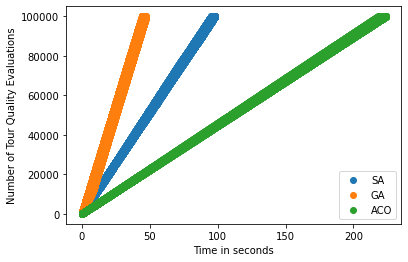

In [2]:
# time to evals

import pandas as pd 
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt

files = {
    'SA': 'data/conv-SA-0-None-None-4836.csv',
    'GA': 'data/conv-GA-0-None-None-4987.csv',
    'ACO': 'data/conv-ACO-0-None-None-620.csv'
}
time2evals = {
    'algorithm': [],
    'rsquared': [],
    'intercept': [],
    'coefficient': []
}

for algorithm, file in files.items():
    
    # linear regression time -> evals
    df = pd.read_csv(file)
    x = df.time.values.reshape(-1, 1)
    y = df.evals.values.reshape(-1, 1)
    model = LinearRegression().fit(x, y)
    rsquared = model.score(x, y)
    intercept = model.intercept_[0]
    coefficient = model.coef_[0][0]
    
    # add to dictionary
    time2evals['algorithm'].append(algorithm)
    time2evals['rsquared'].append(rsquared)
    time2evals['intercept'].append(intercept)
    time2evals['coefficient'].append(coefficient)
    
    # scatter plot
    if len(df) > 100000:
        df = df.sample(100000)
    plt.scatter(df.time, df.evals, label = algorithm)
    
# save model values
pd.DataFrame(time2evals).to_csv('data/time2evals.csv', index = None)
    
plt.xlabel('Time in Seconds')
plt.ylabel('Number of Tour Quality Evaluations')
plt.legend()
plt.savefig('data/time2evals.png', dpi = 4000)

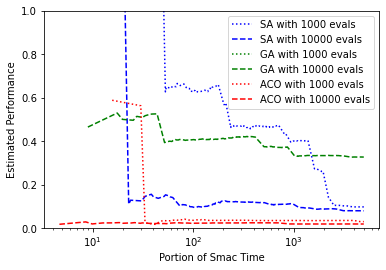

In [19]:
# tuning trajectory smac 

import pandas as pd 
import matplotlib.pyplot as plt  

smac_traj_fnames = {
    'SA': {
        1000: 'data/smac/5000-SA-{qualdev 0, evals 1000}-qualdev/NoScenarioFile/detailed-traj-run-483634792.csv',
        10000: 'data/smac/5000-SA-{qualdev 0, evals 10000}-qualdev/NoScenarioFile/detailed-traj-run-810234963.csv'
    },
    'GA': {
        1000: 'data/smac/5000-GA-{qualdev 0, evals 1000}-qualdev/NoScenarioFile/detailed-traj-run-115943854.csv',
        10000: 'data/smac/5000-GA-{qualdev 0, evals 10000}-qualdev/NoScenarioFile/detailed-traj-run-929863747.csv'
    },
    'ACO': {
        1000: 'data/smac/5000-ACO-{qualdev 0, evals 1000}-qualdev/NoScenarioFile/detailed-traj-run-367701444.csv',
        10000: 'data/smac/5000-ACO-{qualdev 0, evals 10000}-qualdev/NoScenarioFile/detailed-traj-run-421595855.csv'
    }
}

colors = {
    'SA': 'blue',
    'GA': 'green',
    'ACO': 'red'
}

linestyles = {
    1000: 'dotted',
    10000: 'dashed',
}

for algorithm in smac_traj_fnames.keys():
    for evals in smac_traj_fnames[algorithm].keys():
        df = pd.read_csv(smac_traj_fnames[algorithm][evals], header = None, skiprows = 1)
        estimated_training_performance_incumbent = pd.to_numeric(df[1], errors = 'coerce')
        smac_cpu_time = df[4]
        smac_cpu_time = smac_cpu_time * 5000 / smac_cpu_time[len(smac_cpu_time)-1] # normalize time
        label = '{} with {} evals'.format(algorithm, str(evals))
        plt.plot(smac_cpu_time, estimated_training_performance_incumbent, 
                 color = colors[algorithm], linestyle = linestyles[evals], label = label)
    
plt.ylim(0, 1)
plt.semilogx()
# plt.ticklabel_format(axis = 'both', style = 'plain')
    
plt.xlabel('Portion of Smac Time')
plt.ylabel('Estimated Performance')
plt.legend()
plt.savefig('tuning-trajectory-smac.png', dpi = 4000)
plt.show()

In [ ]:
# tuning trajectory irace
import pandas as pd
import matplotlib.pyplot as plt

irace_fnames = {
    'SA': {
        1000: "data/irace/test5000-SA-{'qualdev': 0, 'evals': 1000}-qualdev",
        10000: "data/irace/test5000-SA-{'qualdev': 0, 'evals': 10000}-qualdev"
    },
    'GA': {
        1000: "data/irace/test5000-GA-{'qualdev': 0, 'evals': 1000}-qualdev",
        10000: "data/irace/test5000-GA-{'qualdev': 0, 'evals': 10000}-qualdev"
    },
    'ACO': {
        1000: "data/irace/test5000-ACO-{'qualdev': 0, 'evals': 1000}-qualdev",
        10000: "data/irace/test5000-ACO-{'qualdev': 0, 'evals': 10000}-qualdev"
    }
}

fname = "data/irace/test5000-SA-{'qualdev': 0, 'evals': 1000}-qualdev"
fiterations = fname + '-iterations.csv'
ftest_experiments = fname + '-test-experiments.csv'

test_experiments = pd.read_csv(ftest_experiments)
test_experiments_mean = test_experiments.mean()
iterations = pd.read_csv(fiterations)

tuning_trajectory = [( row.experiments, test_experiments_mean[str(row.elite)] ) \
                         for index, row in iterations.iterrows()]


In [ ]:
# heatmaps tuning budget - evals : qualdev 
# one heatmap per algorithm

import pandas as pd 
import matplotlib.pyplot as plt  
import seaborn as sns

smac_traj_fnames = {
    'SA': {
        1000: 'data/smac/5000-SA-{qualdev 0, evals 1000}-qualdev/NoScenarioFile/detailed-traj-run-483634792.csv',
        10000: 'data/smac/5000-SA-{qualdev 0, evals 10000}-qualdev/NoScenarioFile/detailed-traj-run-810234963.csv'
    },
    'GA': {
        1000: 'data/smac/5000-GA-{qualdev 0, evals 1000}-qualdev/NoScenarioFile/detailed-traj-run-115943854.csv',
        10000: 'data/smac/5000-GA-{qualdev 0, evals 10000}-qualdev/NoScenarioFile/detailed-traj-run-929863747.csv'
    },
    'ACO': {
        1000: 'data/smac/5000-ACO-{qualdev 0, evals 1000}-qualdev/NoScenarioFile/detailed-traj-run-367701444.csv',
        10000: 'data/smac/5000-ACO-{qualdev 0, evals 10000}-qualdev/NoScenarioFile/detailed-traj-run-421595855.csv'
    }
}

for algorithm in smac_traj_fnames.keys():
    for evals in smac_traj_fnames[algorithm].keys():
        df = pd.read_csv(smac_traj_fnames[algorithm][evals], header = None, skiprows = 1)
        estimated_training_performance_incumbent = pd.to_numeric(df[1], errors = 'coerce')
        smac_cpu_time = df[4]
        smac_cpu_time = smac_cpu_time * 5000 / smac_cpu_time[len(smac_cpu_time)-1] # normalize time
        label = '{} with {} evals'.format(algorithm, str(evals))
        plt.plot(smac_cpu_time, estimated_training_performance_incumbent, 
                 color = colors[algorithm], linestyle = linestyles[evals], label = label)

sns.heatmap(df, annot=True)